# Identifying Credit Default with Machine Learning

In [15]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import matplotlib.pyplot as plt
import warnings

plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = [8, 4.5]
plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)

In [16]:
import pandas as pd
import numpy as np
import random

In [17]:
df = pd.read_csv('credit_card_default.csv', index_col=0, na_values='')
print(f'The DataFrame has {len(df)} rows and {df.shape[1]} columns.')
df.head()

The DataFrame has 30000 rows and 24 columns.


,limit_bal,sex,education,marriage,age,payment_status_sep,payment_status_aug,payment_status_jul,payment_status_jun,payment_status_may,...,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr,default_payment_next_month
0,20000,Female,University,Married,24.0,Payment delayed 2 months,Payment delayed 2 months,Payed duly,Payed duly,Unknown,...,0,0,0,0,689,0,0,0,0,1
1,120000,Female,University,Single,26.0,Payed duly,Payment delayed 2 months,Unknown,Unknown,Unknown,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,Female,University,Single,34.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,Female,University,Married,37.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,Male,University,Married,57.0,Payed duly,Unknown,Payed duly,Unknown,Unknown,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


In [18]:
X = df.copy()
y = X.pop('default_payment_next_month')

In [19]:
df.dtypes

limit_bal                       int64
sex                            object
education                      object
marriage                       object
age                           float64
payment_status_sep             object
payment_status_aug             object
payment_status_jul             object
payment_status_jun             object
payment_status_may             object
payment_status_apr             object
bill_statement_sep              int64
bill_statement_aug              int64
bill_statement_jul              int64
bill_statement_jun              int64
bill_statement_may              int64
bill_statement_apr              int64
previous_payment_sep            int64
previous_payment_aug            int64
previous_payment_jul            int64
previous_payment_jun            int64
previous_payment_may            int64
previous_payment_apr            int64
default_payment_next_month      int64
dtype: object

In [20]:
def get_df_memory_usage(df, top_columns=5):
    '''
    Function for quick analysis of a pandas DataFrame's memory usage.
    It prints the top `top_columns` columns in terms of memory usage 
    and the total usage of the DataFrame.
    
    Parameters
    ------------
    df : pd.DataFrame
        DataFrame to be inspected
    top_columns : int
        Number of top columns (in terms of memory used) to display
    '''
    print('Memory usage ----')
    memory_per_column = df.memory_usage(deep=True) / 1024 ** 2
    print(f'Top {top_columns} columns by memory (MB):')
    print(memory_per_column.sort_values(ascending=False) \
                           .head(top_columns))
    print(f'Total size: {memory_per_column.sum():.4f} MB')

In [21]:
get_df_memory_usage(df, 5)

Memory usage ----
Top 5 columns by memory (MB):
education             1.965001
payment_status_sep    1.954342
payment_status_aug    1.920288
payment_status_jul    1.916343
payment_status_jun    1.904229
dtype: float64
Total size: 20.7012 MB


In [22]:
df_cat = df.copy()
object_columns = df_cat.select_dtypes(include='object').columns
df_cat[object_columns] = df_cat[object_columns].astype('category')

In [23]:
get_df_memory_usage(df_cat)

Memory usage ----
Top 5 columns by memory (MB):
Index                   0.228882
bill_statement_aug      0.228882
previous_payment_apr    0.228882
previous_payment_may    0.228882
previous_payment_jun    0.228882
dtype: float64
Total size: 3.9265 MB


In [24]:
column_dtypes = {'education': 'category', 
                 'marriage': 'category', 
                 'sex': 'category',
                 'payment_status_sep': 'category', 
                 'payment_status_aug': 'category', 
                 'payment_status_jul': 'category',       
                 'payment_status_jun': 'category', 
                 'payment_status_may': 'category', 
                 'payment_status_apr': 'category'}
df_cat2 = pd.read_csv('credit_card_default.csv', index_col=0, 
                      na_values='', dtype=column_dtypes)

In [25]:
get_df_memory_usage(df_cat2)

Memory usage ----
Top 5 columns by memory (MB):
Index                   0.228882
bill_statement_aug      0.228882
previous_payment_apr    0.228882
previous_payment_may    0.228882
previous_payment_jun    0.228882
dtype: float64
Total size: 3.9264 MB


In [26]:
df_cat.equals(df_cat2)

True

### Exploratory Data Analysis

In [27]:
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
import plotly.io as pio

In [28]:
df.describe().transpose().round(2)

,count,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,167484.32,129747.66,10000.0,50000.00,140000.0,240000.00,1000000.0
age,29850.0,35.49,9.22,21.0,28.00,34.0,41.00,79.0
bill_statement_sep,30000.0,51223.33,73635.86,-165580.0,3558.75,22381.5,67091.00,964511.0
bill_statement_aug,30000.0,49179.08,71173.77,-69777.0,2984.75,21200.0,64006.25,983931.0
bill_statement_jul,30000.0,47013.15,69349.39,-157264.0,2666.25,20088.5,60164.75,1664089.0
bill_statement_jun,30000.0,43262.95,64332.86,-170000.0,2326.75,19052.0,54506.00,891586.0
bill_statement_may,30000.0,40311.40,60797.16,-81334.0,1763.00,18104.5,50190.50,927171.0
bill_statement_apr,30000.0,38871.76,59554.11,-339603.0,1256.00,17071.0,49198.25,961664.0
previous_payment_sep,30000.0,5663.58,16563.28,0.0,1000.00,2100.0,5006.00,873552.0
previous_payment_aug,30000.0,5921.16,23040.87,0.0,833.00,2009.0,5000.00,1684259.0


In [29]:
# Get summary statistics for categorical variables

df.describe(include='object').transpose()

,count,unique,top,freq
sex,29850,2,Female,18027
education,29850,4,University,13960
marriage,29850,3,Single,15891
payment_status_sep,30000,10,Unknown,17496
payment_status_aug,30000,10,Unknown,19512
payment_status_jul,30000,10,Unknown,19849
payment_status_jun,30000,10,Unknown,20803
payment_status_may,30000,9,Unknown,21493
payment_status_apr,30000,9,Unknown,21181


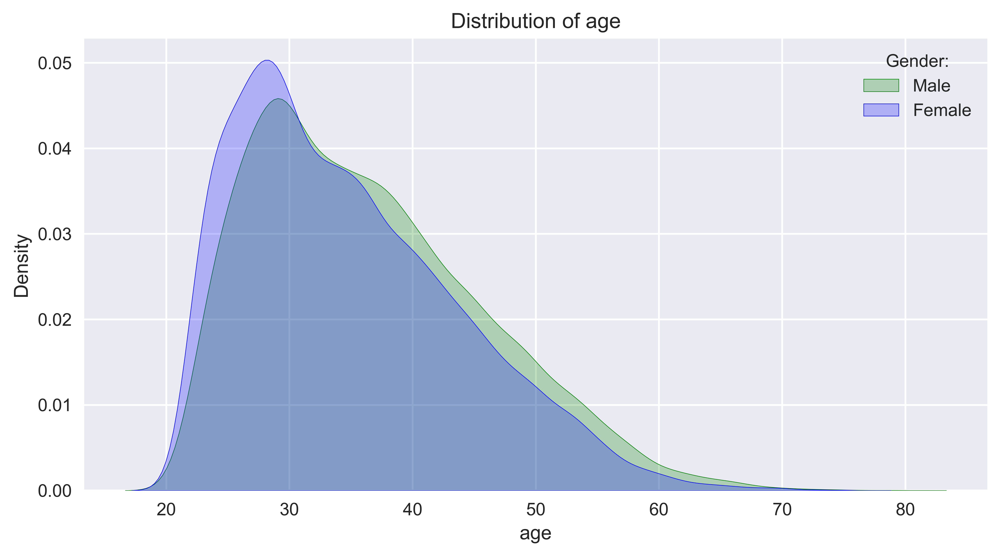

In [30]:
# Plot the distribution of age and split it by gender

fig, ax = plt.subplots()
sns.distplot(df.loc[df.sex=='Male', 'age'].dropna(), 
             hist=False, color='green', 
             kde_kws={'shade': True},
             ax=ax, label='Male')
sns.distplot(df.loc[df.sex=='Female', 'age'].dropna(), 
             hist=False, color='blue', 
             kde_kws={'shade': True},
             ax=ax, label='Female')
ax.set_title('Distribution of age')
ax.legend(title='Gender:')

plt.tight_layout()
# plt.savefig('images/ch8_im5.png')
plt.show()

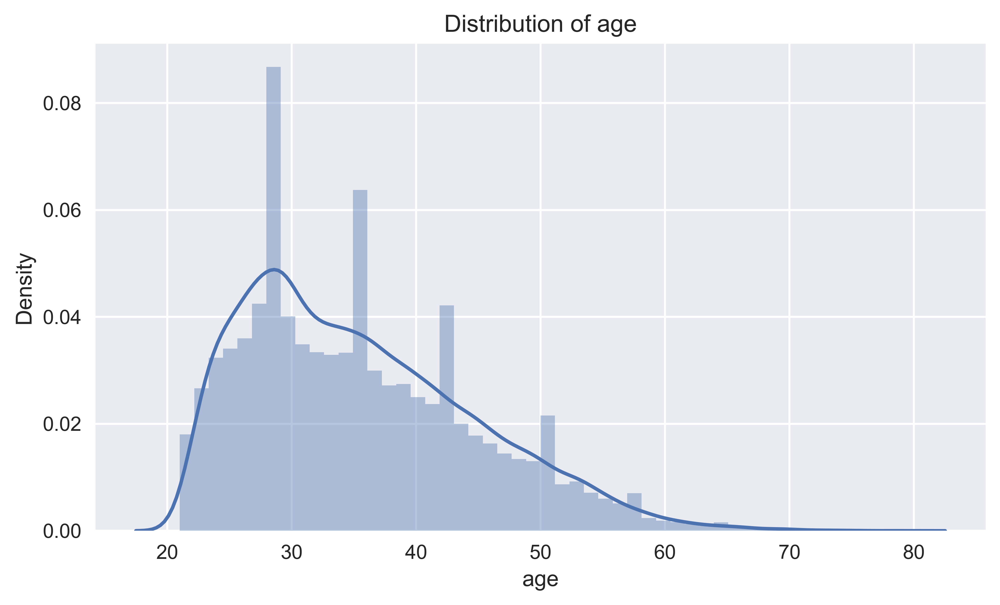

In [31]:
ax = sns.distplot(df.age.dropna(), )
ax.set_title('Distribution of age');

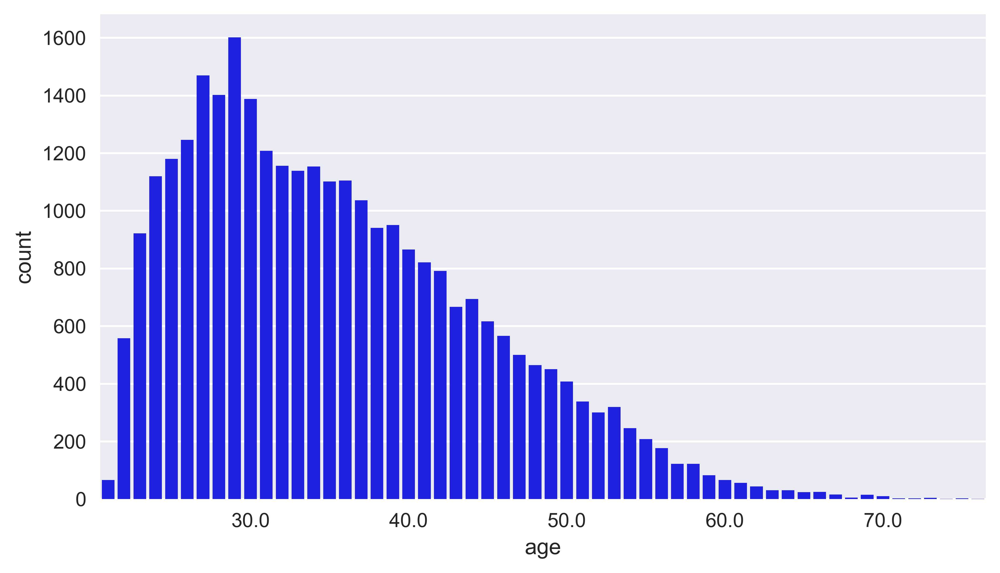

In [32]:
# We noticed some spikes appearing every ~10 years and the reason for this is the binning. 
# Below, we created the same histogram using `sns.countplot` and `plotly_express`. 
# By doing so, each value of age has a separate bin and we can inspect the plot in detail. There are no such spikes in the following plots:

plot_ = sns.countplot(x=df.age.dropna(), color='blue')

for ind, label in enumerate(plot_.get_xticklabels()):
    if int(float(label.get_text())) % 10 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)

In [33]:
px.histogram(df, x='age', title = 'Distribution of age')

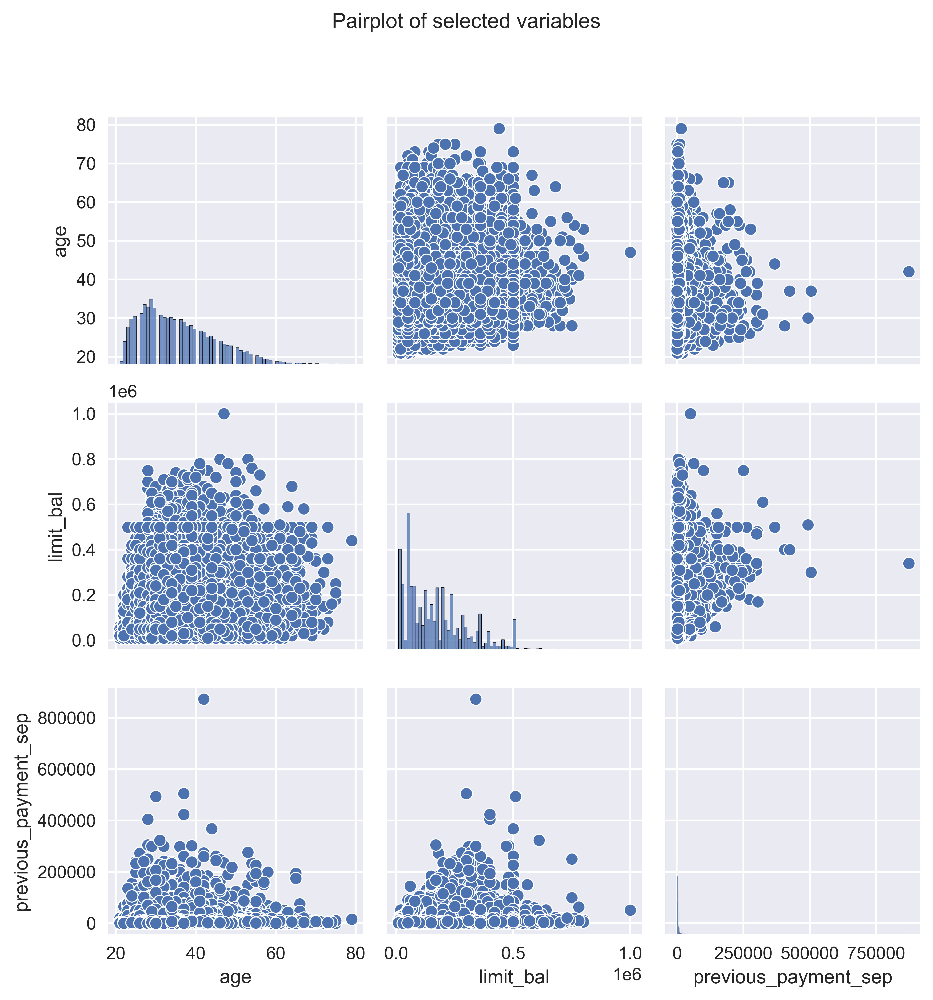

In [34]:
pair_plot = sns.pairplot(df[['age', 'limit_bal', 'previous_payment_sep']])
pair_plot.fig.suptitle('Pairplot of selected variables', y=1.05)

plt.tight_layout()
plt.show()

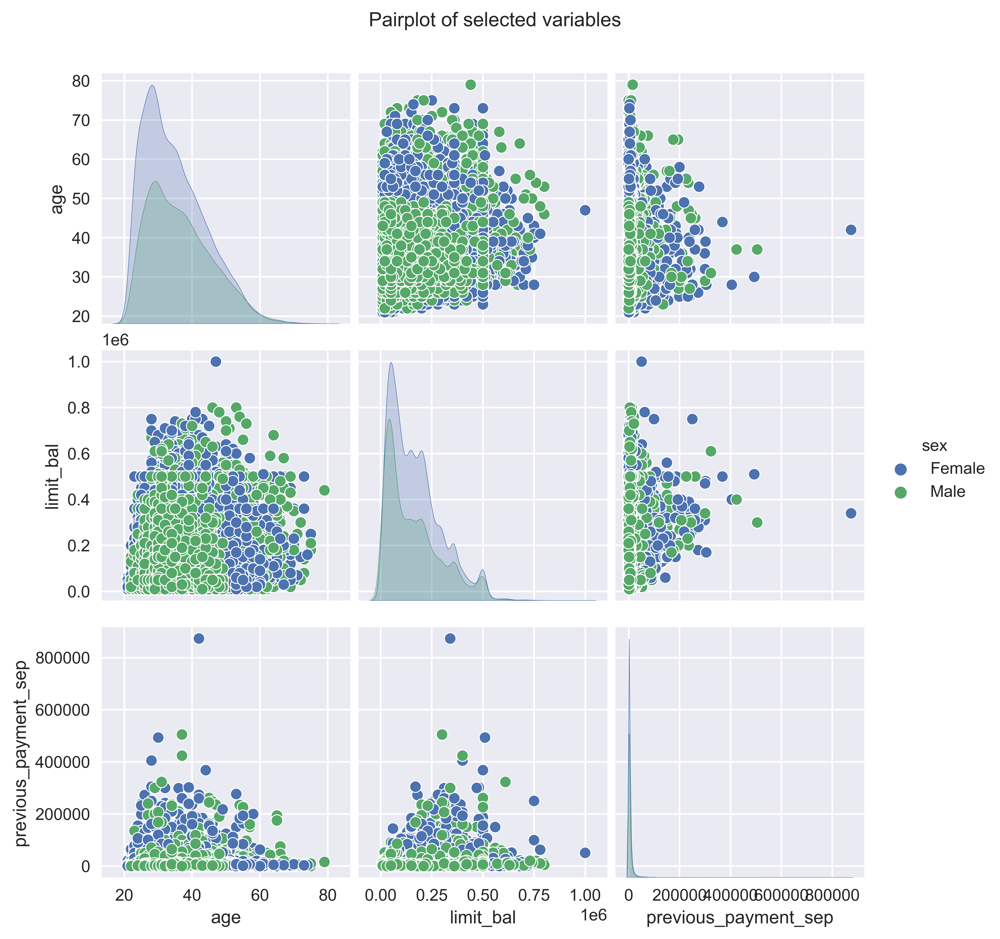

In [35]:
# Additionally, we can separate the genders by specifying the `hue` argument:

pair_plot = sns.pairplot(df[['sex', 'age', 'limit_bal', 'previous_payment_sep']], 
                         hue='sex')
pair_plot.fig.suptitle('Pairplot of selected variables', y=1.05);

In [36]:
# Define and run a function for plotting the correlation heatmap

def plot_correlation_matrix(corr_mat):
    '''
    Function for plotting the correlation heatmap. It masks the irrelevant fields.
    
    Parameters
    ----------
    corr_mat : pd.DataFrame
        Correlation matrix of the features.
    '''
    
    # temporarily change style
    sns.set(style='white')
    # mask the upper triangle
    mask = np.zeros_like(corr_mat, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    # set up the matplotlib figure
    fig, ax = plt.subplots()
    # set up custom diverging colormap
    cmap = sns.diverging_palette(240, 10, n=9, as_cmap=True)
    # plot the heatmap
    sns.heatmap(corr_mat, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, 
                cbar_kws={'shrink': .5}, ax=ax)
    ax.set_title('Correlation Matrix', fontsize=16)
    # change back to darkgrid style
    sns.set(style='darkgrid')

C:\Users\gabrielanatalia\AppData\Local\Temp\ipykernel_24832\1977919745.py:16: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



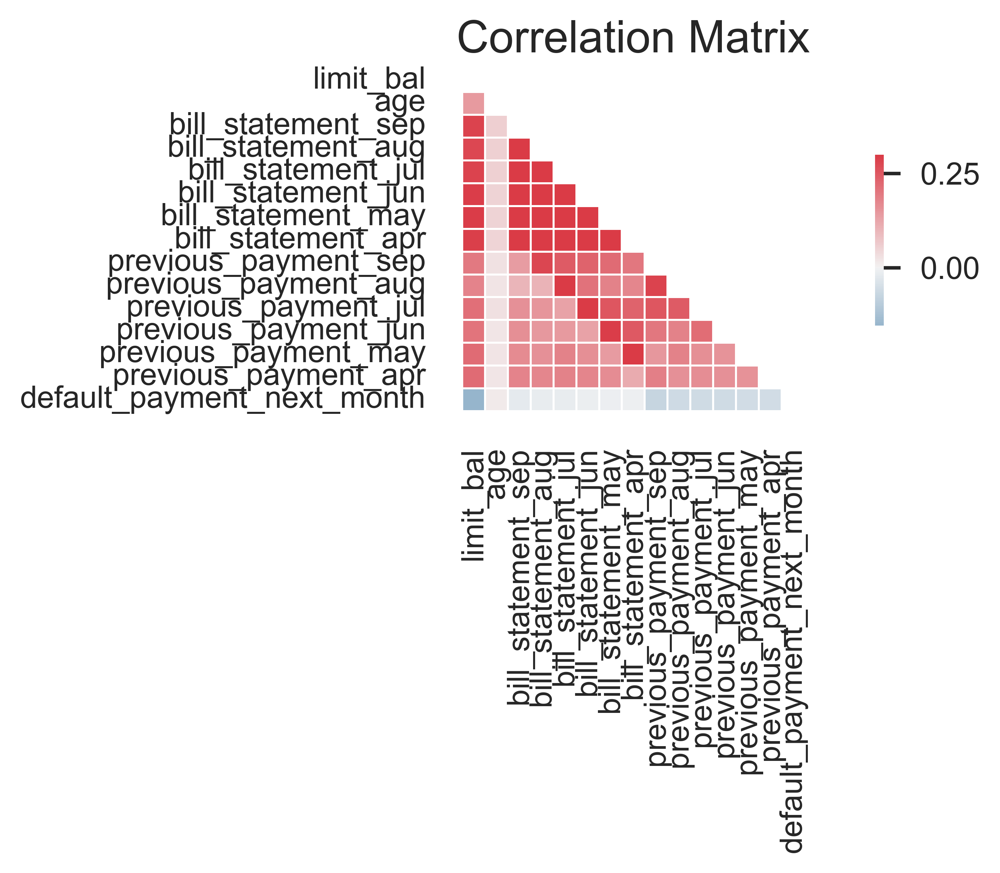

In [37]:
corr_mat = df.select_dtypes(include='number').corr()    
plot_correlation_matrix(corr_mat)

plt.tight_layout()
plt.rcParams['figure.figsize'] = [10,5]
plt.show()

In [38]:
# We can also directly inspect the correlation between the features (numerical) and the target

df.select_dtypes(include='number').corr()[['default_payment_next_month']]

,default_payment_next_month
limit_bal,-0.153520
age,0.014491
bill_statement_sep,-0.019644
bill_statement_aug,-0.014193
bill_statement_jul,-0.014076
bill_statement_jun,-0.010156
bill_statement_may,-0.006760
bill_statement_apr,-0.005372
previous_payment_sep,-0.072929
previous_payment_aug,-0.058579


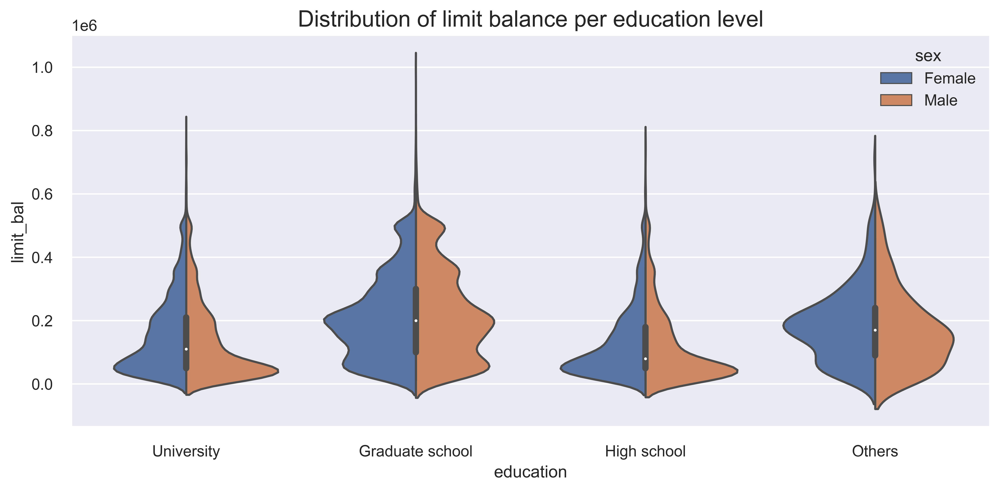

In [39]:
ax = sns.violinplot(x='education', y='limit_bal', 
                    hue='sex', split=True, data=df)
ax.set_title('Distribution of limit balance per education level', 
             fontsize=16)

plt.tight_layout()
plt.rcParams['figure.figsize'] = [10,5]
plt.show()

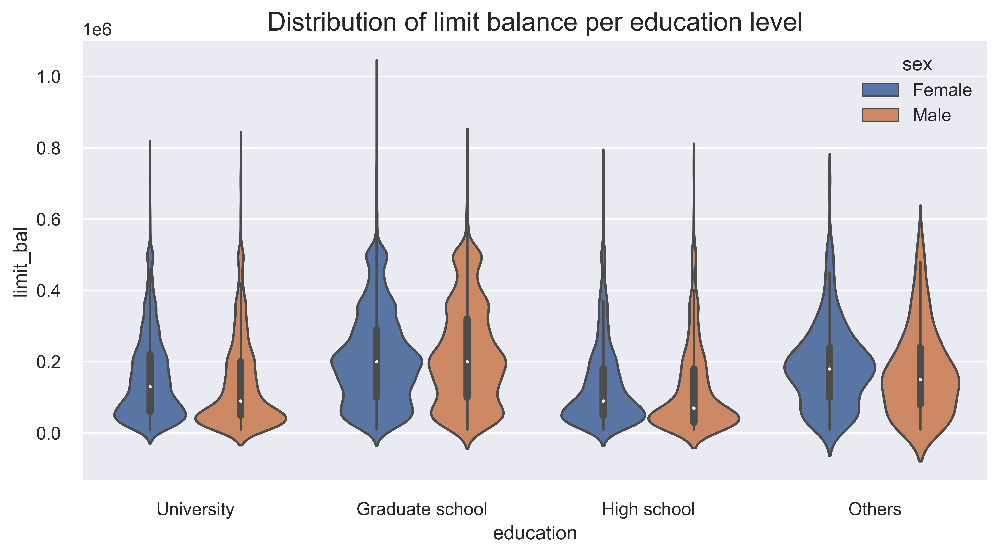

In [40]:
# The following code plots the same information, without splitting the violin plots.

ax = sns.violinplot(x='education', y='limit_bal', 
                    hue='sex', data=df)
ax.set_title('Distribution of limit balance per education level', 
             fontsize=16);

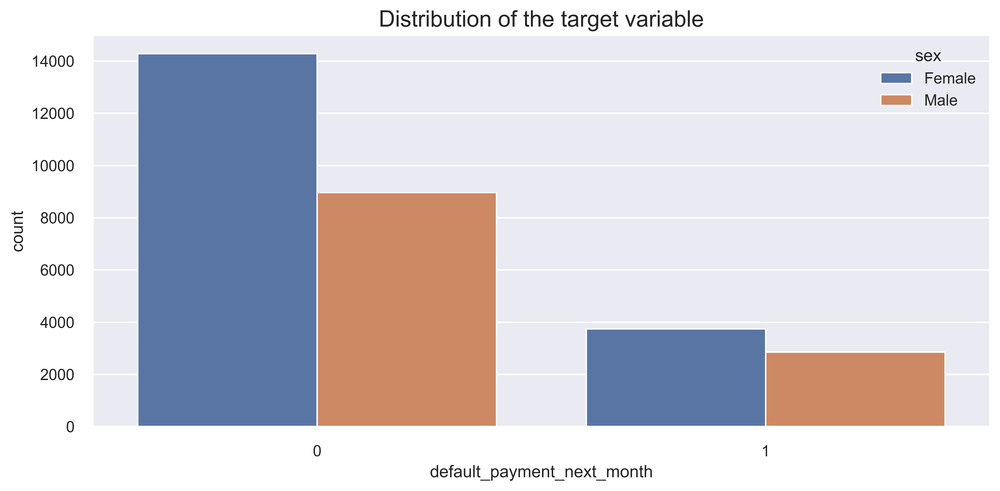

In [41]:
# Investigate the distribution of the target variable per gender and education level

ax = sns.countplot('default_payment_next_month', hue='sex', 
                   data=df, orient='h')
ax.set_title('Distribution of the target variable', fontsize=16)

plt.tight_layout()
plt.rcParams['figure.figsize'] = [8,3]
plt.show()

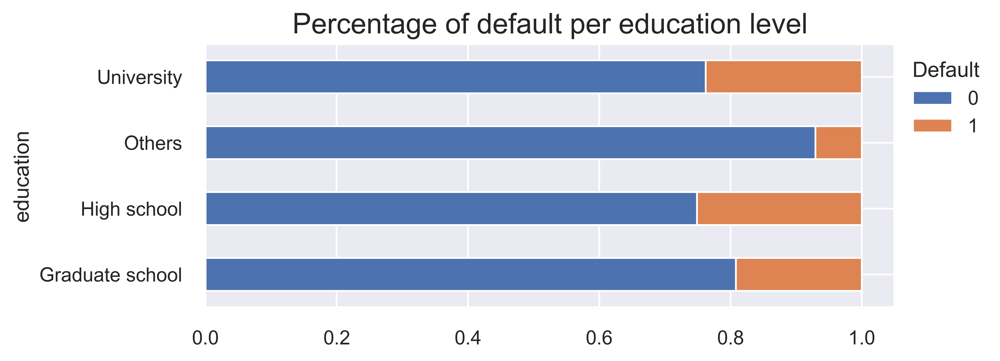

In [42]:
# Investigate the percentage of defaults per education level

ax = df.groupby('education')['default_payment_next_month'] \
       .value_counts(normalize=True) \
       .unstack() \
       .plot(kind='barh', stacked='True')
ax.set_title('Percentage of default per education level', 
             fontsize=16)
ax.legend(title='Default', bbox_to_anchor=(1,1)) 

plt.tight_layout()
plt.show()

In [44]:
import pandas_profiling
df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Splitting the data into training and test sets

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    random_state=42)

In [47]:
# Split the data into training and test sets without shuffling:
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    shuffle=False)

In [48]:
# Split the data into training and test sets with stratification:

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

In [49]:
# Verify that the ratio of the target is preserved

y_train.value_counts(normalize=True)

0    0.778792
1    0.221208
Name: default_payment_next_month, dtype: float64

In [50]:
y_test.value_counts(normalize=True)

0    0.778833
1    0.221167
Name: default_payment_next_month, dtype: float64

In [51]:
# define the size of the validation and test sets
VALID_SIZE = 0.1
TEST_SIZE = 0.2

# create the initial split - training and temp
X_train, X_temp, y_train, y_temp = train_test_split(X, y, 
                                                    test_size=(VALID_SIZE + TEST_SIZE), 
                                                    stratify=y, 
                                                    random_state=42)

# calculate the new test size
NEW_TEST_SIZE = np.around(TEST_SIZE / (VALID_SIZE + TEST_SIZE), 2)

# create the valid and test sets
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, 
                                                    test_size=NEW_TEST_SIZE, 
                                                    stratify=y_temp, 
                                                    random_state=42)

### Dealing with Missing Values

In [52]:
import pandas as pd 
import missingno
from sklearn.impute import SimpleImputer

In [53]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 0 to 29999
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             30000 non-null  int64  
 1   sex                   29850 non-null  object 
 2   education             29850 non-null  object 
 3   marriage              29850 non-null  object 
 4   age                   29850 non-null  float64
 5   payment_status_sep    30000 non-null  object 
 6   payment_status_aug    30000 non-null  object 
 7   payment_status_jul    30000 non-null  object 
 8   payment_status_jun    30000 non-null  object 
 9   payment_status_may    30000 non-null  object 
 10  payment_status_apr    30000 non-null  object 
 11  bill_statement_sep    30000 non-null  int64  
 12  bill_statement_aug    30000 non-null  int64  
 13  bill_statement_jul    30000 non-null  int64  
 14  bill_statement_jun    30000 non-null  int64  
 15  bill_statement_may 

In [54]:
# Visualizie the nullity of the dataframe
missingno.matrix(X)

plt.show()

In [55]:
# Define columns with missing values per data type:
NUM_FEATURES = ['age']
CAT_FEATURES = ['sex', 'education', 'marriage']

In [56]:
# Impute the numerical feature

for col in NUM_FEATURES:
    num_imputer = SimpleImputer(strategy='median')
    num_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = num_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = num_imputer.transform(X_test[[col]])

In [ ]:
# alternative method using pandas

# for feature in NUM_FEATURES:
#     median_value = X_train[feature].median()
#     X_train.loc[:, feature].fillna(median_value, inplace=True)
#     X_test.loc[:, feature].fillna(median_value, inplace=True)

In [57]:
# Impute categorical feature

for col in CAT_FEATURES:
    cat_imputer = SimpleImputer(strategy='most_frequent')
    cat_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = cat_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = cat_imputer.transform(X_test[[col]])

In [ ]:
# alternative method using pandas

# for feature in CAT_FEATURES:
#     mode_value = X_train[feature].mode().values[0]
#     X_train.loc[:, feature].fillna(mode_value, inplace=True)
#     X_test.loc[:, feature].fillna(mode_value, inplace=True)

In [58]:
# Verify that there are no missing values 

X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20999 entries, 25553 to 27126
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             20999 non-null  int64  
 1   sex                   20999 non-null  object 
 2   education             20999 non-null  object 
 3   marriage              20999 non-null  object 
 4   age                   20999 non-null  float64
 5   payment_status_sep    20999 non-null  object 
 6   payment_status_aug    20999 non-null  object 
 7   payment_status_jul    20999 non-null  object 
 8   payment_status_jun    20999 non-null  object 
 9   payment_status_may    20999 non-null  object 
 10  payment_status_apr    20999 non-null  object 
 11  bill_statement_sep    20999 non-null  int64  
 12  bill_statement_aug    20999 non-null  int64  
 13  bill_statement_jul    20999 non-null  int64  
 14  bill_statement_jun    20999 non-null  int64  
 15  bill_statement_

### Encoding categorical variables

In [60]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer

In [61]:
# Use Label Encoder to encode a selected column:

COL = 'education'

X_train_copy = X_train.copy()
X_test_copy = X_test.copy()

label_enc = LabelEncoder()
label_enc.fit(X_train_copy[COL])
X_train_copy.loc[:, COL] = label_enc.transform(X_train_copy[COL])
X_test_copy.loc[:, COL] = label_enc.transform(X_test_copy[COL])

In [62]:
# Select categorical feature for one-hot encoding

CAT_FEATURES = X_train.select_dtypes(include='object') \
                      .columns \
                      .to_list()

In [63]:
# Instantiate the One-Hot Encoder object

one_hot_encoder = OneHotEncoder(sparse=False, 
                                handle_unknown='error', 
                                drop='first')

In [64]:
# Create the column transformer using the one-hot encoder

one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, CAT_FEATURES)]
    #,remainder='passthrough'
)

In [65]:
# Fit the transformer 

one_hot_transformer.fit(X_train)

ColumnTransformer(transformers=[('one_hot',
                                 OneHotEncoder(drop='first', sparse=False),
                                 ['sex', 'education', 'marriage',
                                  'payment_status_sep', 'payment_status_aug',
                                  'payment_status_jul', 'payment_status_jun',
                                  'payment_status_may',
                                  'payment_status_apr'])])

In [66]:
# Apply transformation for both training and test datasets  

col_names = one_hot_transformer.get_feature_names()

X_train_cat = pd.DataFrame(one_hot_transformer.transform(X_train), 
                           columns=col_names, 
                           index=X_train.index)
X_train_ohe = pd.concat([X_train, X_train_cat], axis=1) \
                .drop(CAT_FEATURES, axis=1)

X_test_cat = pd.DataFrame(one_hot_transformer.transform(X_test), 
                          columns=col_names, 
                          index=X_test.index)
X_test_ohe = pd.concat([X_test, X_test_cat], axis=1) \
               .drop(CAT_FEATURES, axis=1)

#### Using `pandas.get_dummies` for one-hot encoding

In [67]:
pd.get_dummies(X_train, prefix_sep='_', drop_first=True)

,limit_bal,age,bill_statement_sep,bill_statement_aug,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,...,payment_status_may_Payment delayed 8 months,payment_status_may_Unknown,payment_status_apr_Payment delayed 2 months,payment_status_apr_Payment delayed 3 months,payment_status_apr_Payment delayed 4 months,payment_status_apr_Payment delayed 5 months,payment_status_apr_Payment delayed 6 months,payment_status_apr_Payment delayed 7 months,payment_status_apr_Payment delayed 8 months,payment_status_apr_Unknown
25553,320000,37.0,202442,187475,164694,148160,132230,121191,8211,6100,...,0,1,0,0,0,0,0,0,0,1
14463,500000,35.0,1369,6138,20424,7840,846,790,4769,19629,...,0,1,0,0,0,0,0,0,0,0
27267,160000,42.0,14137,13613,14634,16532,15969,17701,0,1247,...,0,0,1,0,0,0,0,0,0,0
18620,20000,26.0,1000,8930,0,0,0,790,8930,0,...,0,1,0,0,0,0,0,0,0,1
12238,20000,22.0,11999,3617,4165,6323,0,0,1062,1000,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25780,200000,32.0,10701,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
13921,120000,24.0,112336,113351,115515,113948,122127,121962,4200,4100,...,0,1,1,0,0,0,0,0,0,0
3794,120000,24.0,75796,76004,67187,49924,33188,19826,3700,2023,...,0,1,0,0,0,0,0,0,0,1
27565,360000,57.0,0,0,860,246,-46,-46,0,860,...,0,0,0,0,0,0,0,0,0,1


In [68]:
# Specifying possible categories for OneHotEncoder

one_hot_encoder = OneHotEncoder(
    categories=[['Male', 'Female', 'Unknown']], 
    sparse=False, 
    handle_unknown='error', 
    drop='first'
)

one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, ['sex'])]
)

one_hot_transformer.fit(X_train)
one_hot_transformer.get_feature_names()

['one_hot__x0_Female', 'one_hot__x0_Unknown']

### Category Encoders library

In [70]:
import category_encoders as ce

In [71]:
one_hot_encoder_ce = ce.OneHotEncoder(use_cat_names=True)

In [72]:
one_hot_encoder_ce.fit(X_train)
X_train_ce = one_hot_encoder_ce.transform(X_train)
X_train_ce.head()

,limit_bal,sex_Female,sex_Male,education_University,education_Graduate school,education_High school,education_Others,marriage_Married,marriage_Single,marriage_Others,...,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr
25553,320000,1,0,1,0,0,0,1,0,0,...,164694,148160,132230,121191,8211,6100,6094,5035,4446,5028
14463,500000,0,1,0,1,0,0,0,1,0,...,20424,7840,846,790,4769,19629,157,0,790,860
27267,160000,0,1,0,1,0,0,1,0,0,...,14634,16532,15969,17701,0,1247,2145,0,2000,0
18620,20000,1,0,0,1,0,0,0,1,0,...,0,0,0,790,8930,0,0,0,790,0
12238,20000,1,0,1,0,0,0,0,1,0,...,4165,6323,0,0,1062,1000,10488,0,0,0


In [73]:
target_encoder = ce.TargetEncoder(smoothing=0)
target_encoder.fit(X_train.sex, y_train)
target_encoder.transform(X_train.sex).head()

,sex
25553,0.206948
14463,0.243113
27267,0.243113
18620,0.206948
12238,0.206948


### Fitting a decision tree classifier

In [76]:
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import metrics

from utils import performance_evaluation_report

from io import StringIO
import seaborn as sns
from ipywidgets import Image
import pydotplus 


In [77]:
# Create the instance of the model, fit it to the training data and create prediction

tree_classifier = DecisionTreeClassifier(random_state=42)
tree_classifier.fit(X_train_ohe, y_train)
y_pred = tree_classifier.predict(X_test_ohe)

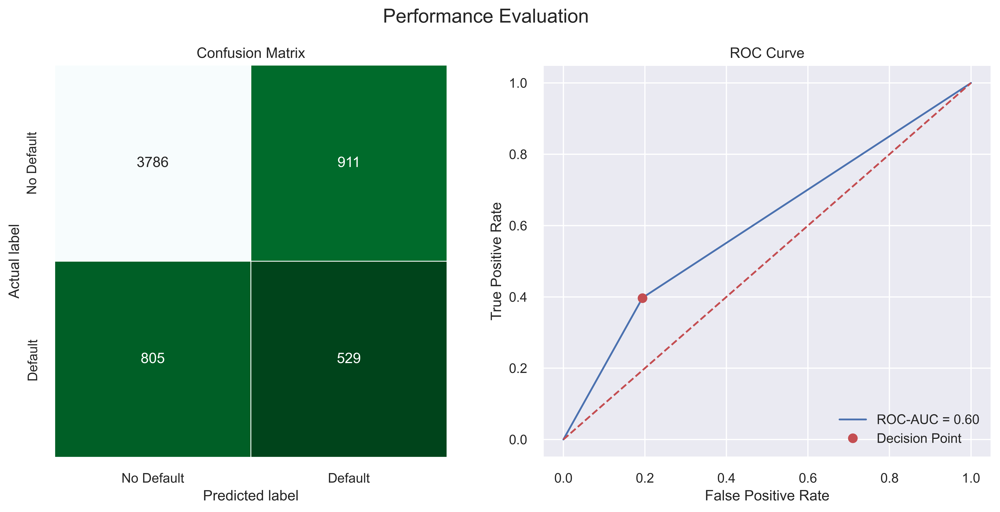

In [78]:
LABELS = ['No Default', 'Default']
tree_perf = performance_evaluation_report(tree_classifier, 
                                          X_test_ohe, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

plt.tight_layout()
plt.show()

In [79]:
tree_perf

{'accuracy': 0.7154700712982922,
 'precision': 0.36736111111111114,
 'recall': 0.39655172413793105,
 'specificity': 0.8060464126037896,
 'f1_score': 0.3813987022350397,
 'cohens_kappa': 0.19699436859223496,
 'roc_auc': 0.6016888830441072,
 'pr_auc': 0.44881290572571897}

In [124]:
# Plot the simplified Decision Tree

small_tree = DecisionTreeClassifier(max_depth=3, 
                                    random_state=42)
small_tree.fit(X_train_ohe, y_train)

tree_dot = StringIO()
export_graphviz(small_tree, feature_names=X_train_ohe.columns,
                class_names=LABELS, rounded=True, out_file=tree_dot,
                proportion=False, precision=2, filled=True)
tree_graph = pydotplus.graph_from_dot_data(tree_dot.getvalue())  
tree_graph.set_dpi(300) 

ValueError: Number of labels=24000 does not match number of samples=20999

In [84]:
y_pred_prob = tree_classifier.predict_proba(X_test_ohe)[:, 1]

In [85]:
precision, recall, thresholds = metrics.precision_recall_curve(y_test, 
                                                               y_pred_prob)

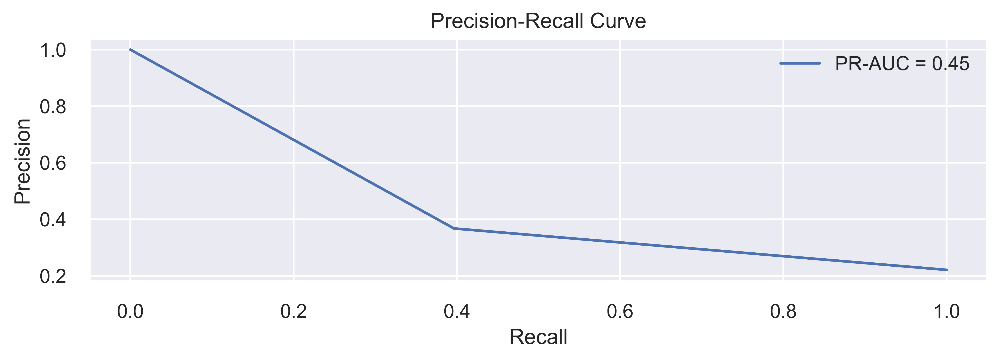

In [86]:
ax = plt.subplot()
ax.plot(recall, precision, 
        label=f'PR-AUC = {metrics.auc(recall, precision):.2f}')
ax.set(title='Precision-Recall Curve', 
       xlabel='Recall', 
       ylabel='Precision')
ax.legend()

plt.tight_layout()
plt.show()

### Implementing scikit-learn's pipelines

In [88]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from utils import performance_evaluation_report

In [89]:
# Load the data, separate the target and create the stratified train-test split:

df = pd.read_csv('credit_card_default.csv', index_col=0, 
                 na_values='')

X = df.copy()
y = X.pop('default_payment_next_month')

X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

In [90]:
# Store lists of numerical/categorical features:

num_features = X_train.select_dtypes(include='number') \
                      .columns \
                      .to_list()
cat_features = X_train.select_dtypes(include='object') \
                      .columns \
                      .to_list()

In [91]:
# Define the numerical pipeline:

num_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median'))
])

In [92]:
# Define the categorical pipeline 

cat_list = [list(X_train[col].dropna().unique()) for col in cat_features]

cat_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(categories=cat_list, sparse=False, 
                             handle_unknown='error', drop='first'))
])

In [93]:
# Define the column transformer object 

preprocessor = ColumnTransformer(transformers=[
    ('numerical', num_pipeline, num_features),
    ('categorical', cat_pipeline, cat_features)],
    remainder='drop')

In [94]:
# Create the joint pipeline  

dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                                ('classifier', dec_tree)])

In [95]:
# Fit the pipeline to the data  

tree_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numerical',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['limit_bal', 'age',
                                                   'bill_statement_sep',
                                                   'bill_statement_aug',
                                                   'bill_statement_jul',
                                                   'bill_statement_jun',
                                                   'bill_statement_may',
                                                   'bill_statement_apr',
                                                   'previous_payment_sep',
                                                   'previous_payment_aug',
                                                   'previous_payment_j...
                                                                                              '3 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '7 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '5 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '8 '
                                                                                              'months']],
                                                                                 drop='first',
                                                                                 sparse=False))]),
                                                  ['sex', 'education',
                                                   'marriage',
                                                   'payment_status_sep',
                                                   'payment_status_aug',
                                                   'payment_status_jul',
                                                   'payment_status_jun',
                                                   'payment_status_may',
                                                   'payment_status_apr'])])),
                ('classifier', DecisionTreeClassifier(random_state=42))])

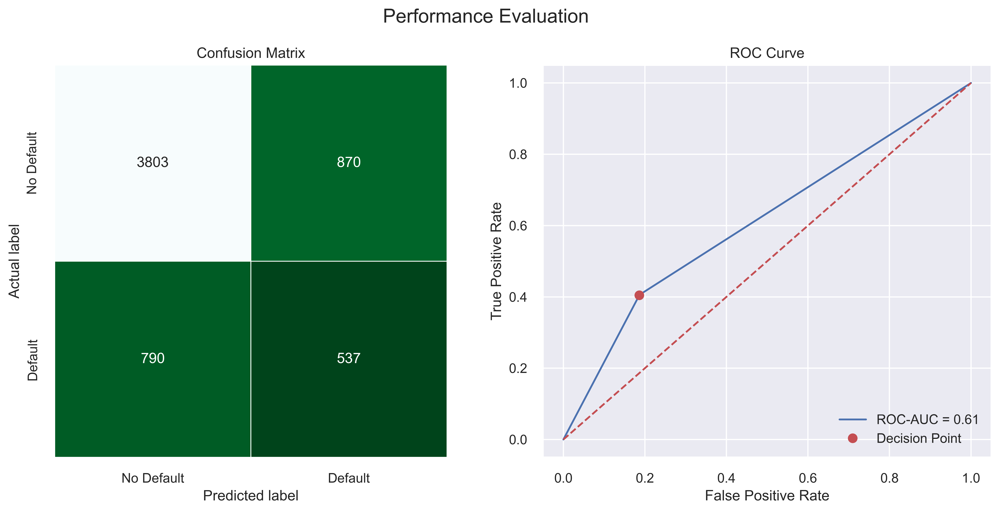

In [96]:
# Evaluate performance of entire Pipeline

LABELS = ['No Default', 'Default']
tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

plt.tight_layout()
plt.show()

In [97]:
tree_perf

{'accuracy': 0.7233333333333334,
 'precision': 0.3816631130063966,
 'recall': 0.4046721929163527,
 'specificity': 0.8138240958698909,
 'f1_score': 0.3928310168251646,
 'cohens_kappa': 0.21388003714653614,
 'roc_auc': 0.6095279347712678,
 'pr_auc': 0.4589251149708047}

In [98]:
from sklearn.base import BaseEstimator, TransformerMixin

In [99]:
class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, n_std=3):
        self.n_std = n_std
    
    def fit(self, X, y = None):
        if np.isnan(X).any(axis=None):
            raise ValueError('''There are missing values in the array! 
                                Please remove them.''')

        mean_vec = np.mean(X, axis=0)
        std_vec = np.std(X, axis=0)
        
        self.upper_band_ = mean_vec + self.n_std * std_vec
        self.lower_band_ = mean_vec - self.n_std * std_vec
        self.n_features_ = len(self.upper_band_)
        
        return self 
    
    def transform(self, X, y = None):
        X_copy = pd.DataFrame(X.copy())
        
        upper_band = np.repeat(
            self.upper_band_.reshape(self.n_features_, -1), 
            len(X_copy), 
            axis=1).transpose()
        lower_band = np.repeat(
            self.lower_band_.reshape(self.n_features_, -1), 
            len(X_copy), 
            axis=1).transpose()
        
        X_copy[X_copy >= upper_band] = upper_band
        X_copy[X_copy <= lower_band] = lower_band
        
        return X_copy.values

In [101]:
# Add the `OutlierRemover` to the numerical Pipeline:

num_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('outliers', OutlierRemover())
])

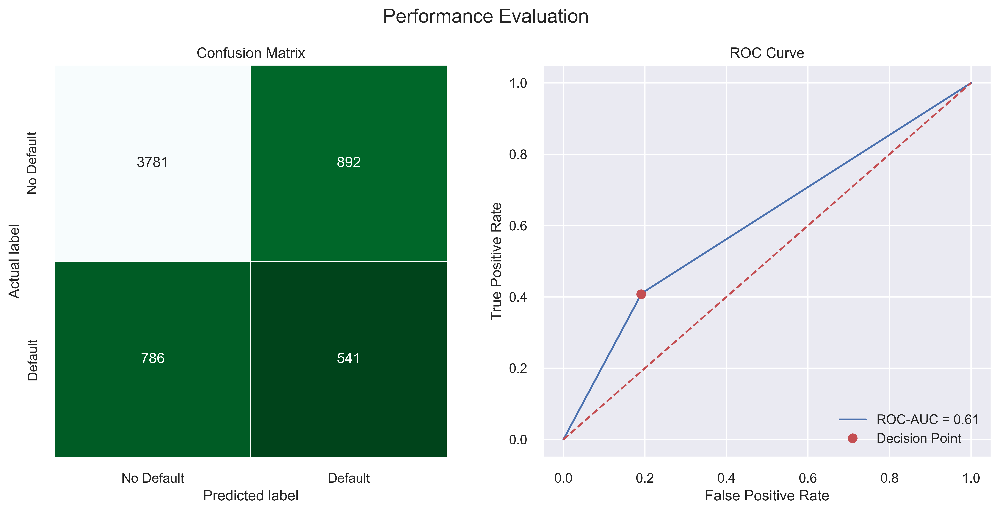

In [102]:
# Run the rest of the pipeline to compare the results 


preprocessor = ColumnTransformer(transformers=[
    ('numerical', num_pipeline, num_features),
    ('categorical', cat_pipeline, cat_features)],
    remainder='drop')

dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                                ('classifier', dec_tree)])

tree_pipeline.fit(X_train, y_train)

tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

plt.tight_layout()
plt.show()

In [103]:
tree_perf

{'accuracy': 0.7203333333333334,
 'precision': 0.377529658060014,
 'recall': 0.4076865109269028,
 'specificity': 0.8091161994436122,
 'f1_score': 0.39202898550724635,
 'cohens_kappa': 0.21077497538963086,
 'roc_auc': 0.608982787005664,
 'pr_auc': 0.4582134167657523}

### Tuning hyperparameters using grid search and cross-validation

In [104]:
from sklearn.model_selection import (GridSearchCV, cross_val_score, 
                                     RandomizedSearchCV, cross_validate, 
                                     StratifiedKFold)
from sklearn import metrics

In [106]:
# Define the cross validation scheme 

k_fold = StratifiedKFold(5, shuffle=True, random_state=42)

In [107]:
# Evaluate the pipeline until cross validation 

cross_val_score(tree_pipeline, X_train, y_train, cv=k_fold)

array([0.72333333, 0.72958333, 0.71375   , 0.723125  , 0.72      ])

In [108]:
# Add extra metrics to cross validation  

cross_validate(tree_pipeline, X_train, y_train, cv=k_fold, 
               scoring=['accuracy', 'precision', 'recall', 
                        'roc_auc'])

{'fit_time': array([0.55590773, 0.73865724, 0.61933875, 0.58496022, 0.51597357]),
 'score_time': array([0.06697249, 0.10208845, 0.0831244 , 0.06152368, 0.06689286]),
 'test_accuracy': array([0.72333333, 0.72958333, 0.71375   , 0.723125  , 0.72      ]),
 'test_precision': array([0.38560411, 0.39557522, 0.36978297, 0.38638298, 0.37674825]),
 'test_recall': array([0.42412818, 0.42090395, 0.41713748, 0.42749529, 0.40583804]),
 'test_roc_auc': array([0.61633282, 0.61893804, 0.60794039, 0.61806569, 0.60712913])}

In [109]:
param_grid = {'classifier__criterion': ['entropy', 'gini'],
              'classifier__max_depth': range(3, 11),
              'classifier__min_samples_leaf': range(2, 11), 
              'preprocessor__numerical__outliers__n_std': [3, 4]}

In [110]:
# Run grid search  

classifier_gs = GridSearchCV(tree_pipeline, param_grid, scoring='recall', 
                             cv=k_fold, n_jobs=-1, verbose=1)

classifier_gs.fit(X_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('numerical',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('outliers',
                                                                                          OutlierRemover())]),
                                                                         ['limit_bal',
                                                                          'age',
                                                                          'bill_statement_sep',
                                                                          'bill_statement_aug',
                                                                          'bill_statement_jul',
                                                                          'bill_statement...
                                                                          'payment_status_jul',
                                                                          'payment_status_jun',
                                                                          'payment_status_may',
                                                                          'payment_status_apr'])])),
                                       ('classifier',
                                        DecisionTreeClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'classifier__criterion': ['entropy', 'gini'],
                         'classifier__max_depth': range(3, 11),
                         'classifier__min_samples_leaf': range(2, 11),
                         'preprocessor__numerical__outliers__n_std': [3, 4]},
             scoring='recall', verbose=1)

In [111]:
print(f'Best parameters: {classifier_gs.best_params_}') 
print(f'Recall (Training set): {classifier_gs.best_score_:.4f}') 
print(f'Recall (Test set): {metrics.recall_score(y_test, classifier_gs.predict(X_test)):.4f}')

Best parameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775


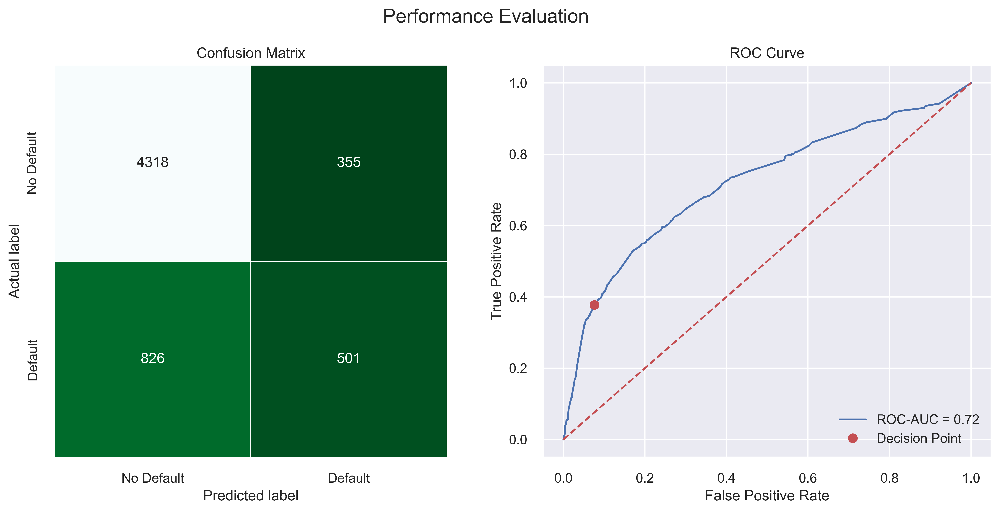

In [112]:
LABELS = ['No Default', 'Default']
tree_gs_perf = performance_evaluation_report(classifier_gs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

plt.tight_layout()
plt.show()

In [113]:
tree_gs_perf

{'accuracy': 0.8031666666666667,
 'precision': 0.5852803738317757,
 'recall': 0.3775433308214017,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45900137425561155,
 'cohens_kappa': 0.34547526291831954,
 'roc_auc': 0.7205480311384921,
 'pr_auc': 0.4698784893189859}

In [115]:
# Run randomized grid search  

classifier_rs = RandomizedSearchCV(tree_pipeline, param_grid, scoring='recall', 
                                   cv=k_fold, n_jobs=-1, verbose=1, 
                                   n_iter=100, random_state=42)
classifier_rs.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('numerical',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('outliers',
                                                                                                OutlierRemover())]),
                                                                               ['limit_bal',
                                                                                'age',
                                                                                'bill_statement_sep',
                                                                                'bill_statement_aug',
                                                                                'bill_statement_jul',
                                                                                'bill_sta...
                                                                                'payment_status_may',
                                                                                'payment_status_apr'])])),
                                             ('classifier',
                                              DecisionTreeClassifier(random_state=42))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'classifier__criterion': ['entropy',
                                                                  'gini'],
                                        'classifier__max_depth': range(3, 11),
                                        'classifier__min_samples_leaf': range(2, 11),
                                        'preprocessor__numerical__outliers__n_std': [3,
                                                                                     4]},
                   random_state=42, scoring='recall', verbose=1)

In [116]:
print(f'Best parameters: {classifier_rs.best_params_}') 
print(f'Recall (Training set): {classifier_rs.best_score_:.4f}') 
print(f'Recall (Test set): {metrics.recall_score(y_test, classifier_rs.predict(X_test)):.4f}')

Best parameters: {'preprocessor__numerical__outliers__n_std': 3, 'classifier__min_samples_leaf': 7, 'classifier__max_depth': 10, 'classifier__criterion': 'gini'}
Recall (Training set): 0.3854
Recall (Test set): 0.3760


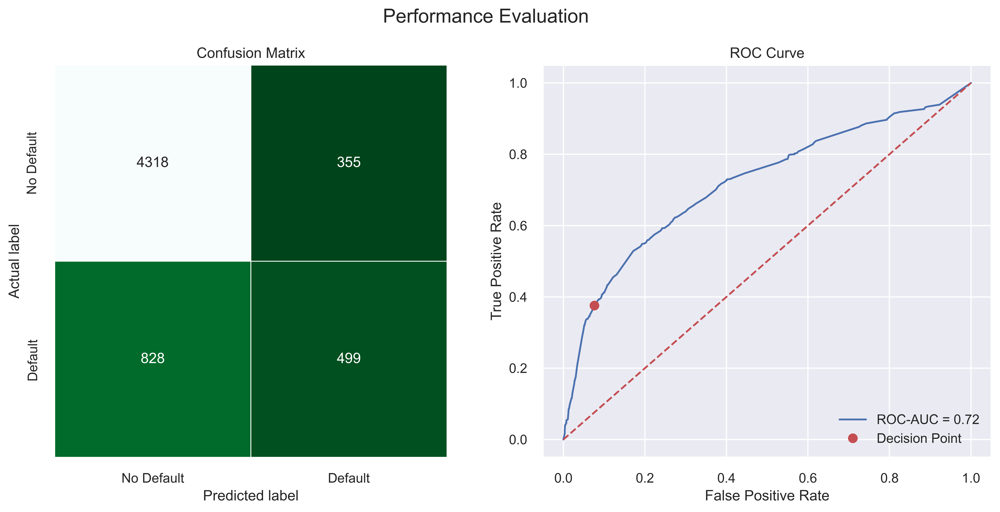

In [118]:
tree_rs_perf = performance_evaluation_report(classifier_rs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

plt.tight_layout()
plt.show()

In [119]:
tree_rs_perf

{'accuracy': 0.8028333333333333,
 'precision': 0.5843091334894613,
 'recall': 0.3760361718161266,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45758826226501603,
 'cohens_kappa': 0.3439613201516819,
 'roc_auc': 0.7188330048148133,
 'pr_auc': 0.4686663337519278}

In [120]:
from sklearn.linear_model import LogisticRegression

In [121]:
param_grid = [{'classifier': [LogisticRegression()],
               'classifier__penalty': ['l1', 'l2'],
               'classifier__C': np.logspace(0, 3, 10, 2),
               'preprocessor__numerical__outliers__n_std': [3, 4]},
              {'classifier': [DecisionTreeClassifier(random_state=42)],
               'classifier__criterion': ['entropy', 'gini'],
               'classifier__max_depth': range(3, 11),
               'classifier__min_samples_leaf': range(2, 11),
               'preprocessor__numerical__outliers__n_std': [3, 4]}]

In [122]:
classifier_gs_2 = GridSearchCV(tree_pipeline, param_grid, scoring='recall', 
                               cv=k_fold, n_jobs=-1, verbose=1)

classifier_gs_2.fit(X_train, y_train)

print(f'Best parameters: {classifier_gs_2.best_params_}') 
print(f'Recall (Training set): {classifier_gs_2.best_score_:.4f}') 
print(f'Recall (Test set): {metrics.recall_score(y_test, classifier_gs_2.predict(X_test)):.4f}')

Fitting 5 folds for each of 328 candidates, totalling 1640 fits


c:\Users\gabrielanatalia\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning:


100 fits failed out of a total of 1640.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
100 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\gabrielanatalia\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\gabrielanatalia\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\pipeline.py", line 382, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "c:\Users\gabrielanatalia\AppD

Best parameters: {'classifier': DecisionTreeClassifier(max_depth=10, min_samples_leaf=7, random_state=42), 'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775
